# Detection and classification of ovarian follicles

## Introduction

intro text motivating the challenge and explaining the importance of studying ovarian follicles. 

This challenge aims at building a machine learning solution for automated classification and counting of follicles on histological sections.
We will distinguish here 4 categories of follicles from smaller to larger follicles: Primordial, Primary, Secondary, Tertiary.

## Data description

Data consist of 34 images of sections taken on 6 mice ovaries. __29 sections in the train__ dataset and __5 sections in the test__ dataset. Each section has been annotated with positive follicles locations and categories. Bounding boxes coordinates and class labels are stored in a csv file named labels.csv, one for each train and test set.
A Negative class has also been created with bounding boxes of various sizes on locations where there is no positive examples of follicles from the 4 retained categories.

## Requirements for running the notebook

In [1]:
# These modules and libraries must be imported to properly run the notebook
import os
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
import sklearn

from operator import itemgetter

Image.MAX_IMAGE_PIXELS = None

2021-11-23 09:21:23.920238: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-11-23 09:21:23.920286: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


# Exploratory data analysis

First uncomment the following line to download the data using this python script. It will create a data folder inside which will be placed the train and test data.

In [2]:
#!python download_data.py

In order to get a feel of what the data look like, let's visualize an image of a section and the corresponding annotations. 

First we need to be able to read and extract bounding boxes coordinates and class names from the csv file.

In [3]:
# Display labels.csv as a pandas dataframe for train set
train_labels = pd.read_csv(os.path.join("data", "train", "labels.csv"))
train_labels.head(10)

,filename,width,height,class,label,xmin,ymin,xmax,ymax
0,D-1M01-2.jpg,4389,4225,Primary,2,3024,2374,3625,2747
1,D-1M01-2.jpg,4389,4225,Primordial,1,404,2191,541,2321
2,D-1M01-2.jpg,4389,4225,Secondary,3,724,2117,1475,2809
3,D-1M01-2.jpg,4389,4225,Secondary,3,1070,550,1777,1218
4,D-1M01-2.jpg,4389,4225,Secondary,3,1954,614,2982,1687
5,D-1M01-3.jpg,5870,5705,Negative,0,860,1261,1660,2093
6,D-1M01-3.jpg,5870,5705,Negative,0,911,3098,1735,4004
7,D-1M01-3.jpg,5870,5705,Negative,0,1280,1038,1571,1201
8,D-1M01-3.jpg,5870,5705,Negative,0,2407,5199,2613,5354
9,D-1M01-3.jpg,5870,5705,Negative,0,2882,5386,3069,5493


This function extract boxes coordinates for true locations (ground truth annotations):

In [4]:
def load_true_locations(path, image_filename):
    """Return list of {bbox, class, proba}."""
    df = pd.read_csv(path)
    df = df.loc[df["filename"] == image_filename] 
    locations = []
    for _, row in df.iterrows():
        loc_dict = {
            "bbox": (row['xmin'], row['ymin'], row['xmax'], row['ymax']),
            "class": row["class"],
            "proba": 1
        }
        locations.append(loc_dict)
    return locations

Here is a function that diplays the image and bounding boxes:

In [5]:
def display_section_and_locations(section, locations):
    linewidth=3
    class_to_color = {
        "Negative": "grey", 
        "Primordial": "blue", 
        "Primary": "red", 
        "Secondary": "green", 
        "Tertiary": "purple"
    }
    
    plt.figure(figsize=(20, 20))
    plt.axis("off")
    plt.imshow(section)
    ax = plt.gca()
    for location in locations:
        box = location["bbox"]
        class_ = location["class"]
        proba = location["proba"]

        color = class_to_color[class_]
        text = "{}: {:.2f}".format(class_, proba)
        linestyle = "-" if proba == 1 else "--"

        x1, y1, x2, y2 = box
        w, h = x2 - x1, y2 - y1
        patch = plt.Rectangle(
            [x1, y1], w, h, fill=False, edgecolor=color, linewidth=linewidth, linestyle=linestyle
        )
        ax.add_patch(patch)

        ax.text(
            x1,
            y1,
            text,
            bbox={"facecolor": color, "alpha": 1},
            clip_box=ax.clipbox,
            clip_on=True,
        )
    plt.show()

In [6]:
this_folder = os.path.abspath("")
DATA_FOLDER = os.path.join(this_folder, "data")
MODELS_FOLDER = os.path.join(this_folder, "models")

IMAGE_TO_ANALYSE = 'D-1M02-2.jpg'

section = Image.open(os.path.join(DATA_FOLDER, "train", IMAGE_TO_ANALYSE))
true_locations = load_true_locations(os.path.join(DATA_FOLDER, "train", 'labels.csv'), IMAGE_TO_ANALYSE)


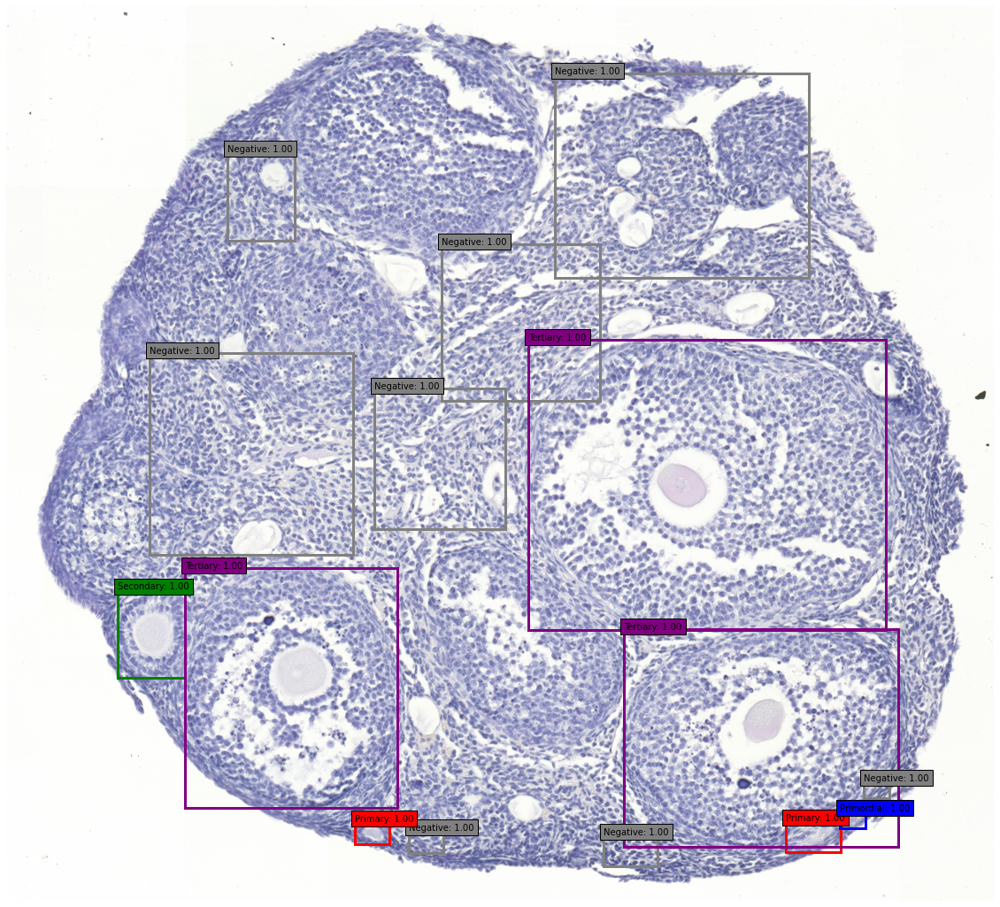

In [7]:

display_section_and_locations(section, true_locations)

Feel free to change IMAGE_TO_ANALYSE name to display other examples.

Now, what is the size distribution of all the ground truth bounding boxes in train set ?
First we make a list of all those locations, and then we count by class and visualize histograms of the width of bounding boxes per class.

In [8]:
def all_true_locations(path):
    labels = pd.read_csv(path)
    all_locations = []
    for _, row in labels.iterrows():
        loc_dict = {
            "bbox": (row['xmin'], row['ymin'], row['xmax'], row['ymax']),
            "class": row["class"],
            "proba": 1
        }
        all_locations.append(loc_dict)
    return all_locations

In [9]:
# List of all locations in train set
all_locations_train = all_true_locations(os.path.join(DATA_FOLDER, "train", 'labels.csv'))
len(all_locations_train)

652

In [10]:
# Count of boxes per class
CLASSES = ['Negative', 'Primordial', 'Primary', 'Secondary', 'Tertiary']
print('Number of boxes per class in the train set:')
for class_ in CLASSES:
    box_count = [1 for location in all_locations_train if location['class']==class_]
    print(f'{class_}: {len(box_count)}')

Number of boxes per class in the train set:
Negative: 328
Primordial: 108
Primary: 75
Secondary: 97
Tertiary: 44


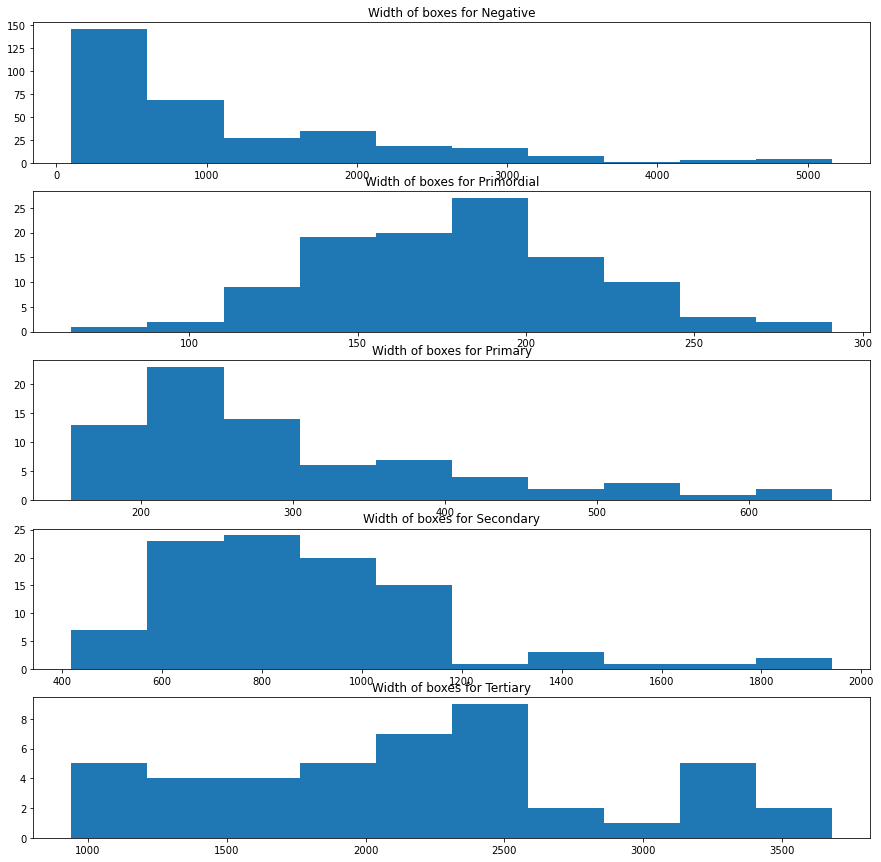

In [11]:
# Histograms of bboxes width
plt.figure(figsize=(15,15))
for i, class_ in enumerate(CLASSES):
    width_list = [location['bbox'][2]-location['bbox'][0]
        for location in all_locations_train if location['class']==class_
    ]
    ax = plt.subplot(5, 1, i+1)
    plt.hist(width_list)
    plt.title(f'Width of boxes for {class_}')

## Multiclass classification

The chosen strategy for the baseline algorithm is a random window cropping followed by a multiclass classification at each extracted window.
First let's build and train the classifier. Here we take a pretrained model on Imagenet and freeze its weights. Then we only train the last fully-connected layer with the training data.

### Building model

In [12]:
# Image shape for classifier
IMG_SHAPE = (224, 224, 3)

# Building of a classification model
base_model = tf.keras.applications.MobileNetV2(
        input_shape=IMG_SHAPE, include_top=False, weights="imagenet"
    )
base_model.trainable = False
inputs = tf.keras.Input(shape=IMG_SHAPE)
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
prediction_layer = tf.keras.layers.Dense(5, activation="softmax")
x = preprocess_input(inputs)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(),
    metrics=["sparse_categorical_accuracy"],
)

model.summary()

2021-11-23 09:22:27.379858: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-11-23 09:22:27.379922: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2021-11-23 09:22:27.379957: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (frcaud-Latitude-7420): /proc/driver/nvidia/version does not exist
2021-11-23 09:22:27.380334: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract (TFOpLambda (None, 224, 224, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 7, 7, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 6405  

### Extracting all training examples from images and creating Xtrain and ytrain for classifier

In [13]:
# Our model takes as input a tensor (M, 224, 224, 3) and
# for each image, a class encoded as an integer.
# Consequently we need to build these images from the files on disc
class_to_index = {
    "Negative": 0,
    "Primordial": 1,
    "Primary": 2,
    "Secondary": 3,
    "Tertiary": 4,
}

X_image_paths = [os.path.join(DATA_FOLDER, "train", filename)
    for filename in train_labels["filename"].unique()
]
y_true_locations = [load_true_locations(os.path.join(DATA_FOLDER, "train", 'labels.csv'), filename)
    for filename in train_labels["filename"].unique()
]

thumbnails = []
expected_predictions = []

for filepath, locations in zip(X_image_paths, y_true_locations):
    print(f"reading {filepath}")
    image = Image.open(filepath)
    for loc in locations:
        class_, bbox = loc["class"], loc["bbox"]
        prediction = class_to_index[class_]
        expected_predictions.append(prediction)
        thumbnail = image.crop(bbox)
        thumbnail = thumbnail.resize((224, 224))
        thumbnail = np.asarray(thumbnail)
        thumbnails.append(thumbnail)
X_for_classifier = np.array(thumbnails)
y_for_classifier = np.array(expected_predictions)


reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M01-2.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M01-3.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M01-4.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M01-5.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M01-6.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-1.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-2.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-3.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-4.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-5.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M02-6.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M03-1.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M03-2.jpg
reading /home/frcaud/frcaud/follicles_detection/data/train/D-1M0

In [14]:
X_for_classifier.shape

(652, 224, 224, 3)

### Training of the classifier

In [15]:
#model.fit(X_for_classifier, y_for_classifier, epochs=100)

In [16]:
# Load model
MODEL_NAME_FOR_PREDICTION = "classifier3"
model = tf.keras.models.load_model(os.path.join(MODELS_FOLDER, MODEL_NAME_FOR_PREDICTION))

In [17]:
def predict_image(image, model):
    image = image.resize((224,224))
    image = np.array(image)
    image = tf.reshape(image, (1,224,224,3))
    pred = model.predict(image)
    return np.argmax(pred), np.max(pred)

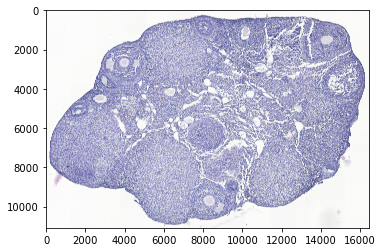

In [18]:
section = Image.open(os.path.join(DATA_FOLDER, 'test', 'D-1M06-1.jpg'))
plt.imshow(section)

Let's make some predictions on cropped images:

2021-11-23 09:24:00.691259: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


(4, 0.9653405)

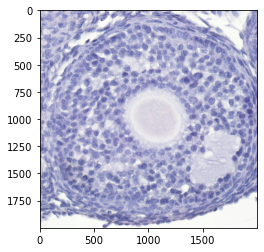

In [19]:
window = section.crop((7250,8700,9250,10700))
plt.imshow(window)

pred = predict_image(window, model)
pred

(0, 0.8341074)

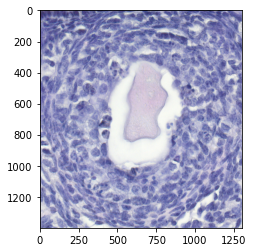

In [20]:
window = section.crop((9500,500,10800,1900))
plt.imshow(window)

pred = predict_image(window, model)
pred

(4, 0.9397855)

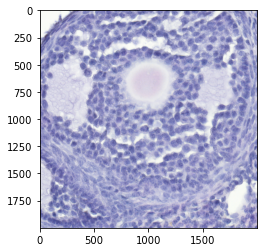

In [21]:
window = section.crop((3000,2000,5000,4000))
plt.imshow(window)

pred = predict_image(window, model)
pred

### Loading test data

In [22]:
test_labels = pd.read_csv(os.path.join("data", "test", "labels.csv"))
test_labels.head(10)

,filename,width,height,class,label,xmin,ymin,xmax,ymax
0,D-1M06-1.jpg,16455,11080,Negative,0,260,5284,3842,8987
1,D-1M06-1.jpg,16455,11080,Negative,0,3909,6545,7827,10518
2,D-1M06-1.jpg,16455,11080,Negative,0,4945,649,8171,3485
3,D-1M06-1.jpg,16455,11080,Negative,0,10334,7227,13106,9911
4,D-1M06-1.jpg,16455,11080,Negative,0,12961,5683,15412,7641
5,D-1M06-1.jpg,16455,11080,Primordial,1,1084,5189,1218,5423
6,D-1M06-1.jpg,16455,11080,Primordial,1,2564,3543,2676,3754
7,D-1M06-1.jpg,16455,11080,Primordial,1,3224,8979,3417,9092
8,D-1M06-1.jpg,16455,11080,Primordial,1,7541,353,7765,505
9,D-1M06-1.jpg,16455,11080,Primordial,1,7792,10523,7971,10601


In [23]:
Xtest_image_paths = [os.path.join(DATA_FOLDER, "test", filename)
    for filename in test_labels["filename"].unique()
]
ytest_true_locations = [load_true_locations(os.path.join(DATA_FOLDER, "test", 'labels.csv'), filename)
    for filename in test_labels["filename"].unique()
]

thumbnails = []
expected_predictions = []

for filepath, locations in zip(Xtest_image_paths, ytest_true_locations):
    print(f"reading {filepath}")
    image = Image.open(filepath)
    for loc in locations:
        class_, bbox = loc["class"], loc["bbox"]
        prediction = class_to_index[class_]
        expected_predictions.append(prediction)
        thumbnail = image.crop(bbox)
        thumbnail = thumbnail.resize((224, 224))
        thumbnail = np.asarray(thumbnail)
        thumbnails.append(thumbnail)
Xtest_for_classifier = np.array(thumbnails)
ytest_for_classifier = np.array(expected_predictions)

reading /home/frcaud/frcaud/follicles_detection/data/test/D-1M06-1.jpg
reading /home/frcaud/frcaud/follicles_detection/data/test/D-1M06-2.jpg
reading /home/frcaud/frcaud/follicles_detection/data/test/D-1M06-3.jpg
reading /home/frcaud/frcaud/follicles_detection/data/test/D-1M06-4.jpg
reading /home/frcaud/frcaud/follicles_detection/data/test/D-1M06-5.jpg


### Evaluation of the classifier
We use model.evaluate with test data to evaluate our model

In [24]:
loss, accuracy = model.evaluate(Xtest_for_classifier, ytest_for_classifier)
print('Test accuracy :', accuracy)

3/3 [==============================] - 1s 175ms/step - loss: 0.4802 - sparse_categorical_accuracy: 0.8143
Test accuracy : 0.8142856955528259


In [25]:
# save model
#model.save(os.path.join(MODELS_FOLDER, "classifier3"))

In [26]:
#def jpg_to_npy(image, split='train'):
#    image_path = os.path.join(DATA_FOLDER, split, image)
#    image_name = image.split(".")[0]
#    im = Image.open(image_path)
#    im = np.array(im)
#    np.save(os.path.join(DATA_FOLDER , split, f"{image_name}.npy"), im)

In [27]:
#jpg_to_npy('D-1M06-1.jpg', split='test')

In [28]:
#np.load(os.path.join(DATA_FOLDER, 'test', 'D-1M06-1.npy')).dtype

Here we make predictions on test set

In [29]:
preds = model.predict(Xtest_for_classifier)
preds = np.argmax(preds, axis=1)
preds

array([0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 4, 4, 4, 0, 0, 0, 0, 0, 3, 0,
       0, 0, 0, 2, 1, 1, 0, 1, 3, 3, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 2, 1,
       1, 1, 1, 1, 4, 0, 0, 2, 0, 0, 4, 1, 3, 3, 0, 0, 0, 0, 2, 1, 0, 1,
       1, 3, 3, 3])

In [30]:
ytest_for_classifier

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 3, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 2, 1, 1, 1, 1, 3, 3, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 1,
       1, 1, 1, 1, 3, 0, 0, 0, 0, 0, 0, 2, 3, 4, 0, 0, 0, 0, 2, 1, 1, 1,
       1, 3, 3, 3])

Confusion matrix:

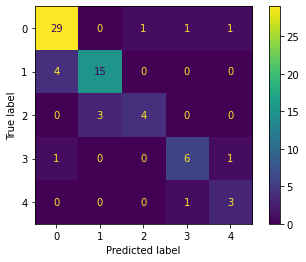

In [31]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
con_mat = confusion_matrix(ytest_for_classifier, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=con_mat)
disp.plot()
plt.show()

Classification report:

In [32]:
from sklearn.metrics import classification_report

print(classification_report(ytest_for_classifier, preds, target_names=["Negative", "Primordial", "Primary", "Secondary", "Tertiary"]))

              precision    recall  f1-score   support

    Negative       0.85      0.91      0.88        32
  Primordial       0.83      0.79      0.81        19
     Primary       0.80      0.57      0.67         7
   Secondary       0.75      0.75      0.75         8
    Tertiary       0.60      0.75      0.67         4

    accuracy                           0.81        70
   macro avg       0.77      0.75      0.75        70
weighted avg       0.82      0.81      0.81        70



# Object detection

The strategy here is to generate random windows on test images and pass them through the classifier. We can choose different mean (window_size) and the window width and height will be drawn from a normal distribution with this mean.

### Random window generator

In [33]:
def generate_random_windows_for_image(image, window_size=1000, num_windows=1000):
    """generator of rectangular boxes that create a list of random
    windows for the given image"""
    mean = window_size
    std = 0.25 * window_size
    
    c = 0
    while True:
        width = np.random.normal(mean, std)
        height = np.random.normal(mean, std)
        x1 = np.random.randint(0, image.width)
        y1 = np.random.randint(0, image.height)

        bbox = (x1, y1, x1 + width, y1 + height)
        yield bbox
        c += 1
        
        if c > num_windows:
            break

### Predictions on windows and filtering of predictions

In [34]:

def predict_locations_for_windows(section, window_size, model, num_windows=1000):
    label_to_class = {
    0: "Negative",
    1: "Primordial",
    2: "Primary",
    3: "Secondary",
    4: "Tertiary",
    }
    boxes = generate_random_windows_for_image(section, window_size=window_size, num_windows=num_windows)
    predicted_locations = []
    for box in boxes:
        cropped_image = section.crop(box)
        label, proba = predict_image(cropped_image, model)
        class_ = label_to_class[label]
        predicted_locations.append({
                "bbox": box,
                "class": class_,
                "proba": proba
            })
    return predicted_locations

def filter_predictions(predicted_locations, proba_threshold=0.8):
    def should_keep_prediction(class_, proba):
        if class_ == "Negative":
            return False
        if proba < proba_threshold:
            return False
        return True

    selected_locations = [
        prediction
        for prediction in predicted_locations
        if should_keep_prediction(prediction["class"], prediction["proba"])
    ]

    return selected_locations


In [35]:
# Predicted locations
predicted_locations = predict_locations_for_windows(section, window_size=1200, model=model, num_windows=1000)

1


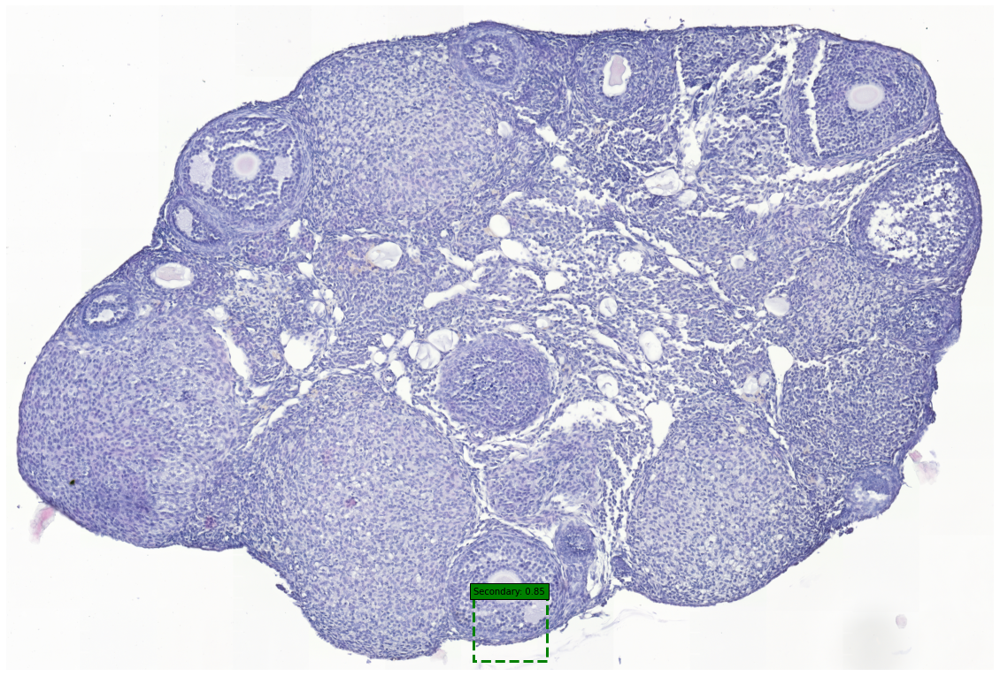

In [36]:
selected_locations = filter_predictions(predicted_locations, proba_threshold=0.80)
print(len(selected_locations))
display_section_and_locations(section, selected_locations)

In [37]:
IMAGE_TO_ANALYSE = 'D-1M06-5.jpg'
section = Image.open(os.path.join(DATA_FOLDER, 'test', IMAGE_TO_ANALYSE))
true_locations = load_true_locations(os.path.join(DATA_FOLDER, "test", 'labels.csv'), IMAGE_TO_ANALYSE)

In [38]:
true_locations

[{'bbox': (2367, 6659, 5535, 10205), 'class': 'Negative', 'proba': 1},
 {'bbox': (5545, 6086, 8551, 10043), 'class': 'Negative', 'proba': 1},
 {'bbox': (9210, 7016, 11113, 9124), 'class': 'Negative', 'proba': 1},
 {'bbox': (10603, 1667, 12738, 4073), 'class': 'Negative', 'proba': 1},
 {'bbox': (3663, 2235, 3879, 2470), 'class': 'Primary', 'proba': 1},
 {'bbox': (477, 7013, 622, 7225), 'class': 'Primordial', 'proba': 1},
 {'bbox': (1712, 7833, 1901, 8004), 'class': 'Primordial', 'proba': 1},
 {'bbox': (3250, 2080, 3361, 2255), 'class': 'Primordial', 'proba': 1},
 {'bbox': (11383, 7598, 11525, 7729), 'class': 'Primordial', 'proba': 1},
 {'bbox': (2023, 3111, 2801, 3983), 'class': 'Secondary', 'proba': 1},
 {'bbox': (4069, 1101, 4990, 2056), 'class': 'Secondary', 'proba': 1},
 {'bbox': (11933, 5173, 12826, 6271), 'class': 'Secondary', 'proba': 1}]

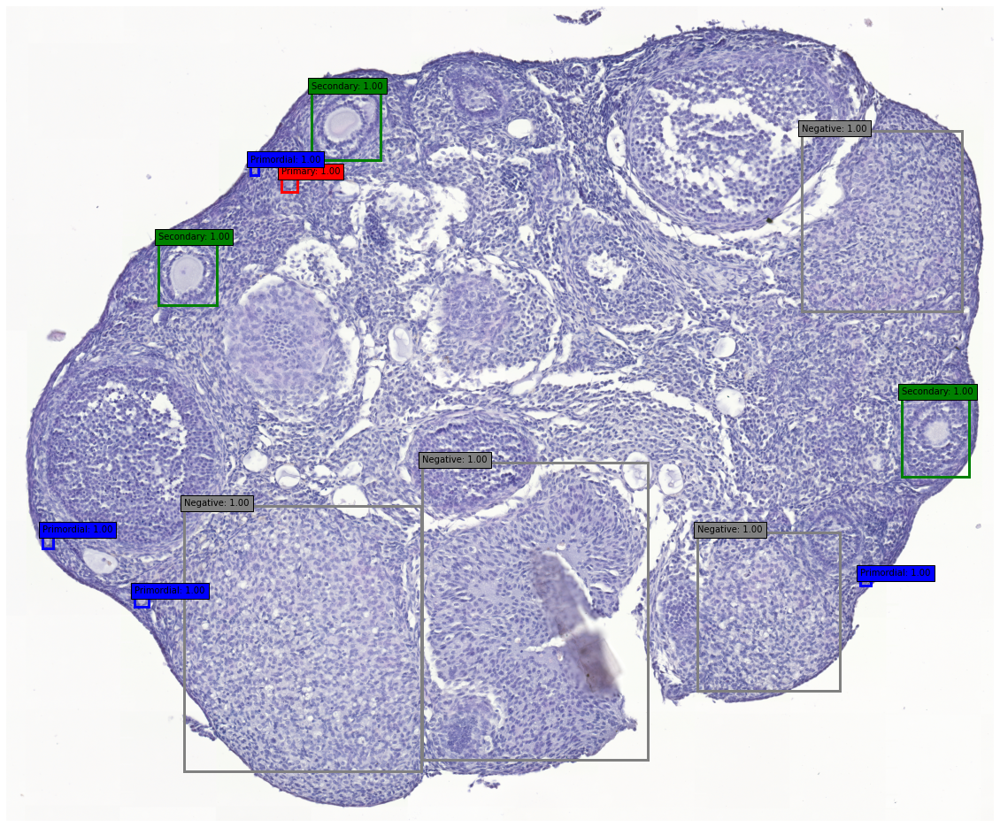

In [39]:
display_section_and_locations(section, true_locations)

In [53]:
predicted_locations = []
for width in [800, 1000, 2000, 3000]:
    predicted_locations += predict_locations_for_windows(section, window_size=width, model=model, num_windows=2000)
len(predicted_locations)

8004

12


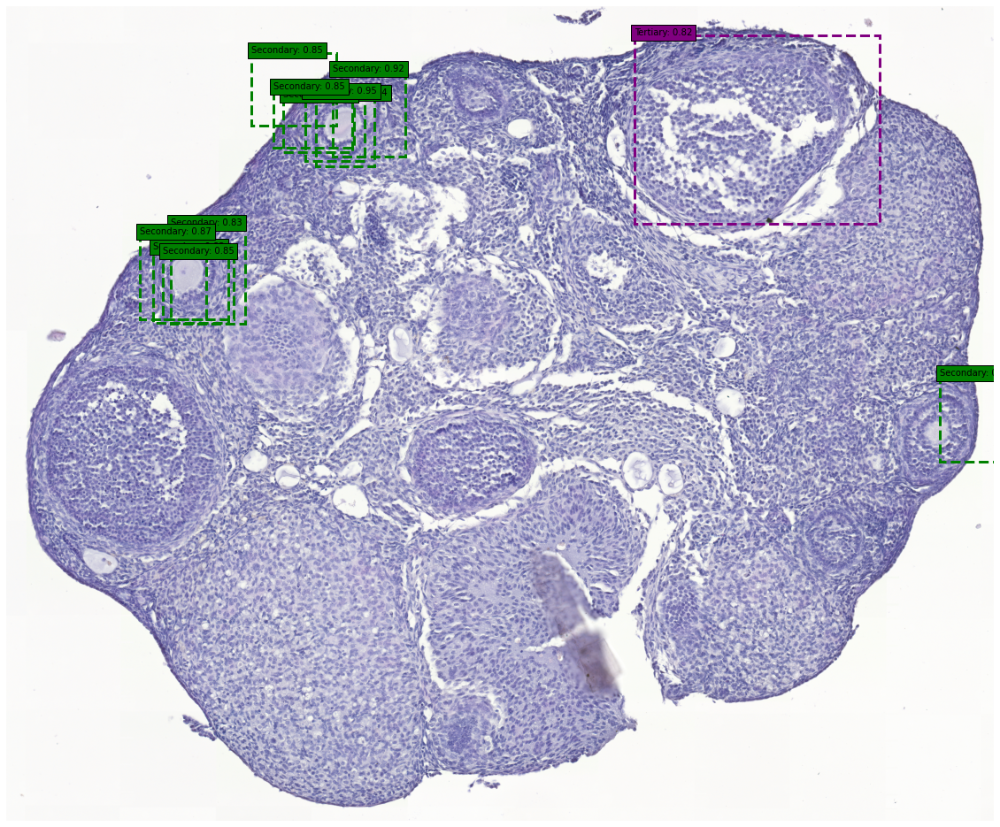

In [54]:
selected_locations = filter_predictions(predicted_locations, proba_threshold=0.80)
print(len(selected_locations))
display_section_and_locations(section, selected_locations)

## IOU-NMS to remove duplicates

In [55]:
def compute_iou(boxes1, boxes2):
    """Computes pairwise IOU matrix for given two sets of boxes

    Arguments:
      boxes1: A tensor with shape `(N, 4)` representing bounding boxes
        where each box is of the format `[x, y, x2, y2]`.
        boxes2: A tensor with shape `(M, 4)` representing bounding boxes
        where each box is of the format `[x, y, xmax, ymax]`.

    Returns:
      pairwise IOU matrix with shape `(N, M)`, where the value at ith row
        jth column holds the IOU between ith box and jth box from
        boxes1 and boxes2 respectively.
    """
    lu = np.maximum(boxes1[:, None, :2], boxes2[:, :2])
    rd = np.minimum(boxes1[:, None, 2:], boxes2[:, 2:])
    intersection = np.maximum(0.0, rd - lu)
    intersection_area = intersection[:, :, 0] * intersection[:, :, 1]
    boxes1_area = (boxes1[:,2] - boxes1[:, 0]) * (boxes1[:,3] - boxes1[:, 1])
    boxes2_area = (boxes2[:,2] - boxes2[:, 0]) * (boxes2[:,3] - boxes2[:, 1])
    union_area = np.maximum(
        boxes1_area[:, None] + boxes2_area - intersection_area, 1e-8
    )
    return np.clip(intersection_area / union_area, 0.0, 1.0)



In [56]:
def NMS(selected_locations, iou_threshold=0.4):
    selected_locations_NMS = []
    selected_locations_sorted = list(sorted(selected_locations, key=itemgetter('proba'), reverse=True))
    # boxes_sorted = np.array([location['bbox'] for location in selected_locations_sorted])
    while len(selected_locations_sorted) !=0:
        best_box = selected_locations_sorted.pop(0)
        selected_locations_NMS.append(best_box)
        best_box_coords = np.array(best_box["bbox"]).reshape(1,-1)
        other_boxes_coords = np.array([location['bbox'] for location in selected_locations_sorted]).reshape(-1,4)
        ious = compute_iou(best_box_coords, other_boxes_coords)
        for i, iou in reversed(list(enumerate(ious[0]))):           
            if iou > iou_threshold:
                selected_locations_sorted.pop(i)
    return selected_locations_NMS

In [84]:
selected_locations_NMS = NMS(selected_locations, iou_threshold=0.2)
len(selected_locations_NMS)

3

In [85]:
selected_locations_NMS

[{'bbox': (4059, 1046, 4897.5525671070955, 2405.4296836681497),
  'class': 'Secondary',
  'proba': 0.86312336},
 {'bbox': (12382, 4852, 12729.783711607968, 4959.058673936182),
  'class': 'Primordial',
  'proba': 0.85472864},
 {'bbox': (296, 7241, 1401.5203203527471, 8170.160150122232),
  'class': 'Secondary',
  'proba': 0.81395507}]

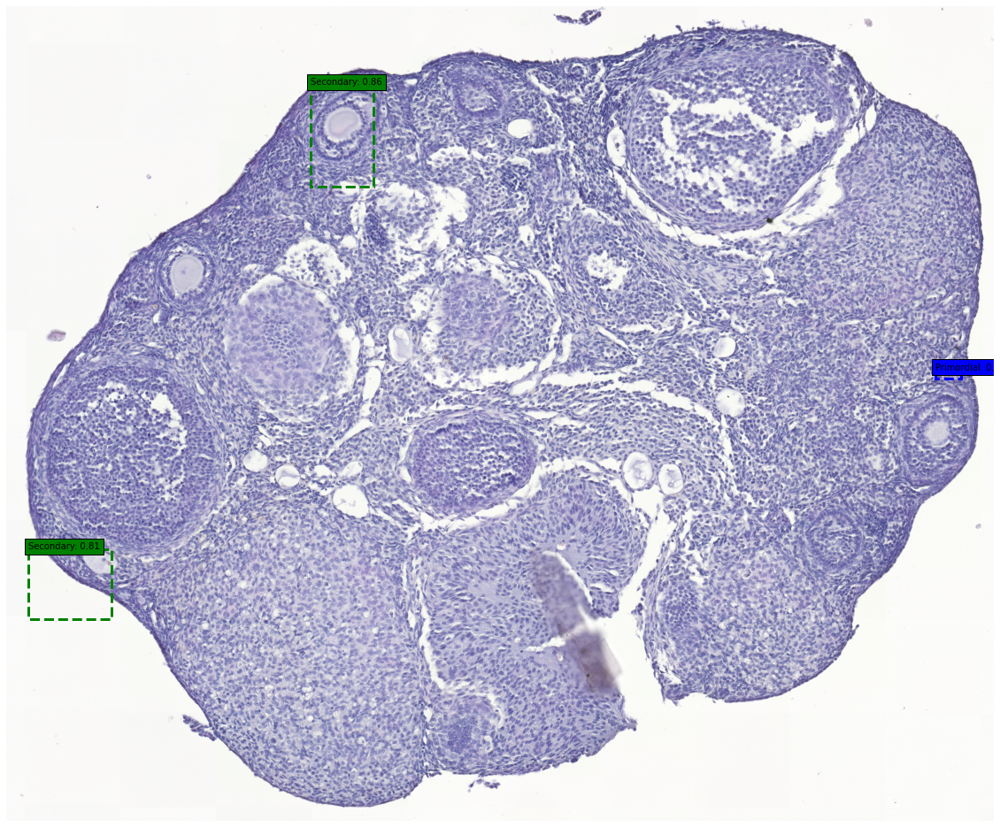

In [86]:
display_section_and_locations(section, selected_locations_NMS)

## Precision-Recall curve

In [60]:
def find_matching_bbox(bbox, list_of_bboxes, iou_threshold):
    """
    
    Return index, success
        index = index of bbox with highest iou
        success = if matching iou is greater than threshold
    """
    ious = compute_iou(np.array([bbox]), np.array(list_of_bboxes))[0, :]
    index, maximum = np.argmax(ious), np.max(ious)
    return index, maximum > iou_threshold

In [61]:
def compute_precision_recall(true_locations, predicted_locations, iou_threshold=0.3):
    classes = [
        "Primordial",
        "Primary",
        "Secondary",
        "Tertiary",
    ]
    precisions = {}
    recalls = {}
    thresholds = {}
    for predicted_class in classes:
        true_boxes = [
            location["bbox"]
            for location in true_locations
            if location["class"] == predicted_class
        ]
        if not true_boxes:
            continue

        pred_boxes = [
            (location["bbox"], location["proba"])
            for location in sorted(predicted_locations, key=lambda loc: loc["proba"], reverse=True)
            if location["class"] == predicted_class
        ]

        precision = []
        recall = []
        threshold = []
        n_positive_detections = 0
        n_true_detected = 0
        n_true_to_detect = len(true_boxes)
        for i, (pred_bbox, proba) in enumerate(pred_boxes):
            if len(true_boxes) > 0:
                index, success = find_matching_bbox(pred_bbox, true_boxes, iou_threshold)
                if success:
                    true_boxes.pop(index)
                    n_positive_detections += 1
                    n_true_detected += 1

            threshold.append(proba)
            precision.append(n_positive_detections / (i +1))
            recall.append(n_true_detected / n_true_to_detect)
            

        precisions[predicted_class] = precision
        recalls[predicted_class] = recall
        thresholds[predicted_class] = threshold

    return precisions, recalls, thresholds

In [62]:
from sklearn.metrics import PrecisionRecallDisplay

def display_metrics(precisions, recalls):
    classes = [
        "Primordial", 
        "Primary",
        "Secondary",
        "Tertiary",
    ]
    colors = ["navy", "turquoise", "darkorange", "cornflowerblue", "teal"]

    _, ax = plt.subplots(figsize=(7, 8))

    APs = {}
    for class_to_predict, color in zip(classes, colors):
        try:
            precision = [1] + precisions[class_to_predict]
            recall = [0] + recalls[class_to_predict]
            average_precision = 0
            for i in range(1, len(precision)):
                average_precision += precision[i] * (recall[i] - recall[i-1])
            APs[class_to_predict] = average_precision
            display = PrecisionRecallDisplay(
                recall=recall,
                precision=precision,
                average_precision=average_precision,
                # linestyle="--"
            )
            display.plot(ax=ax, name=f"Precision-recall for class {class_to_predict}", color=color, marker="o")
        except KeyError:
            pass
    plt.show(ax)
    return APs
    

In [63]:
precisions, recalls, thresholds = compute_precision_recall(true_locations=true_locations, predicted_locations=selected_locations_NMS, iou_threshold=0.3)

In [64]:
precisions, recalls, thresholds

({'Primordial': [],
  'Primary': [],
  'Secondary': [1.0, 0.5, 0.3333333333333333, 0.5, 0.4]},
 {'Primordial': [],
  'Primary': [],
  'Secondary': [0.3333333333333333,
   0.3333333333333333,
   0.3333333333333333,
   0.6666666666666666,
   0.6666666666666666]},
 {'Primordial': [],
  'Primary': [],
  'Secondary': [0.952329, 0.9232365, 0.89169747, 0.8693512, 0.84564275]})

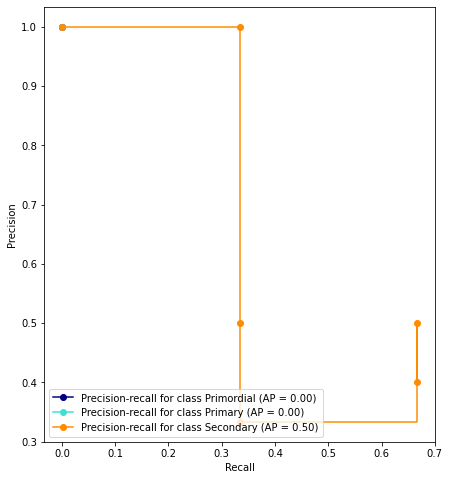

{'Primordial': 0, 'Primary': 0, 'Secondary': 0.5}


In [65]:
APs = display_metrics(precisions, recalls)
print(APs)

## Average precision over the whole test set

In [66]:
IMAGES_TO_ANALYSE = ['D-1M06-1.jpg', 'D-1M06-2.jpg', 'D-1M06-3.jpg', 'D-1M06-4.jpg', 'D-1M06-5.jpg']

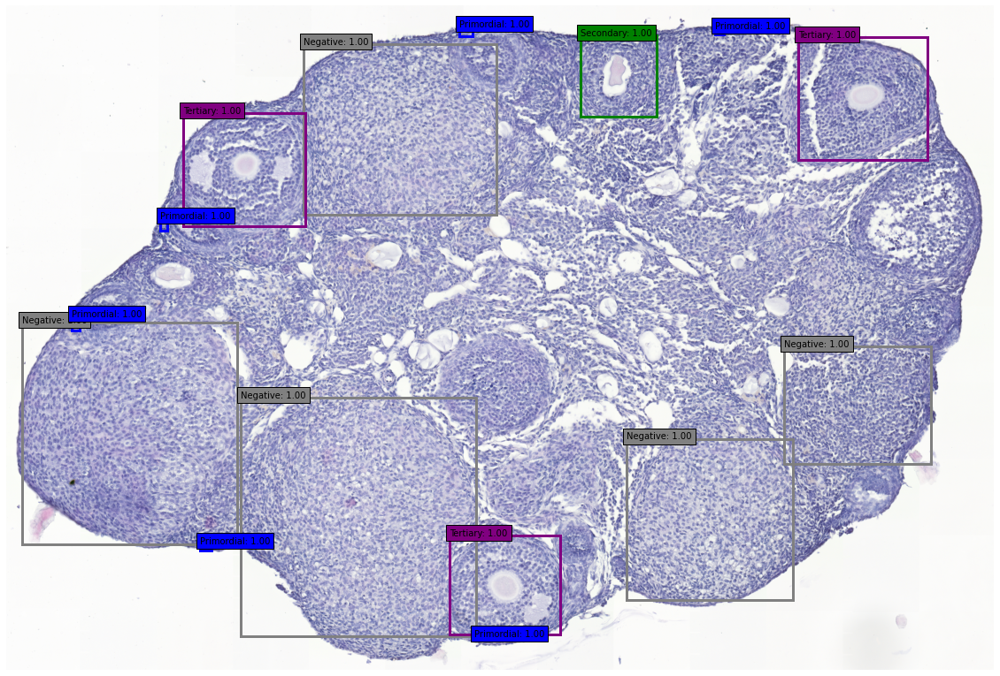

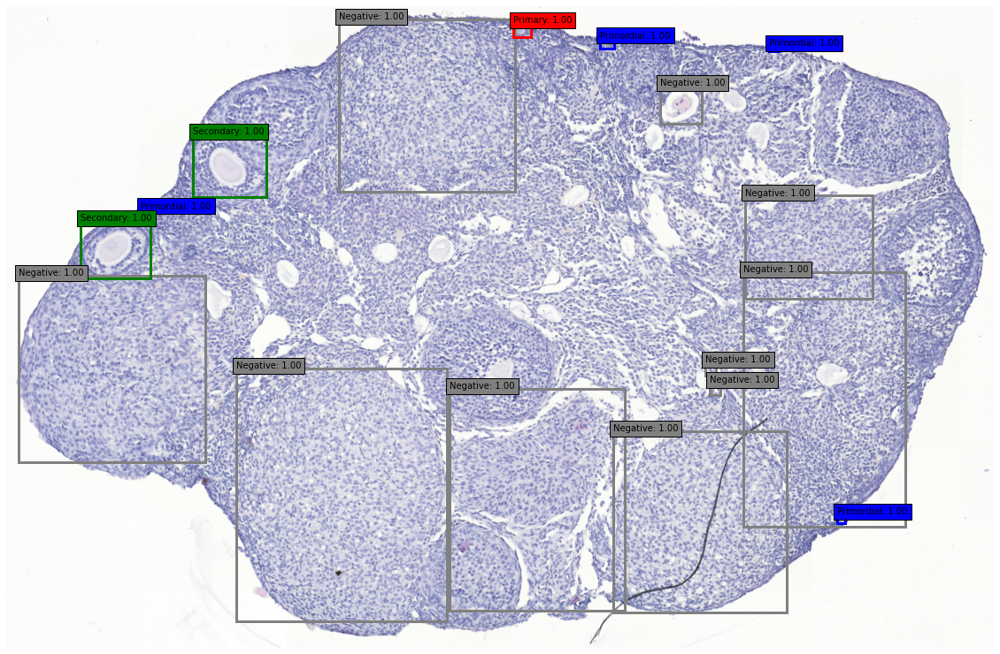

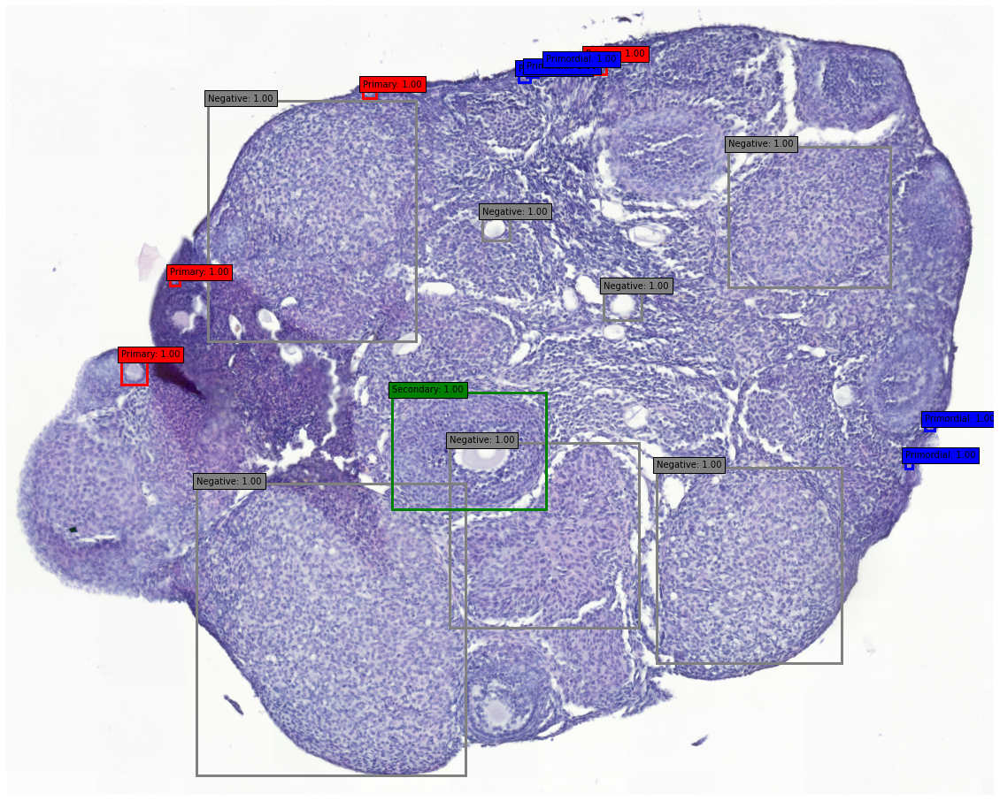

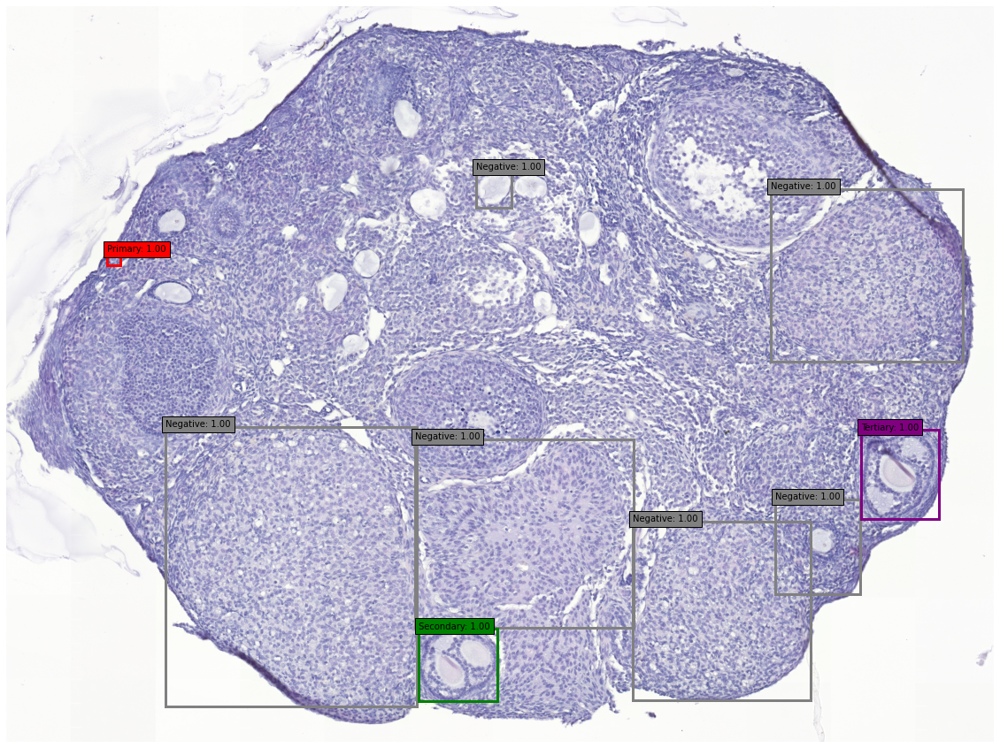

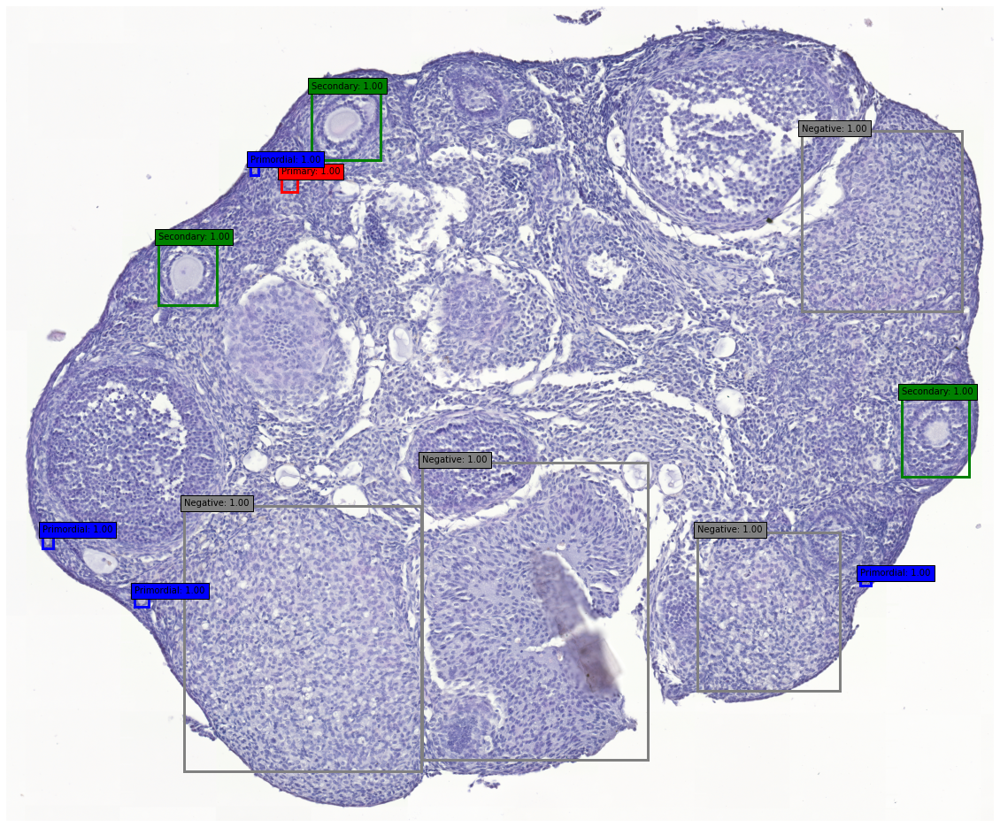

In [67]:
for i, IMAGE_TO_ANALYSE in enumerate(IMAGES_TO_ANALYSE):
    section = Image.open(os.path.join(DATA_FOLDER, 'test', IMAGE_TO_ANALYSE))
    true_locations = load_true_locations(os.path.join(DATA_FOLDER, "test", 'labels.csv'), IMAGE_TO_ANALYSE)
    display_section_and_locations(section, true_locations)

In [75]:
true_locations_test = []
predicted_locations_test = []
for IMAGE_TO_ANALYSE in IMAGES_TO_ANALYSE:
    # load image
    section = Image.open(os.path.join(DATA_FOLDER, 'test', IMAGE_TO_ANALYSE))
    # adding true locations to list for all test images
    true_locations_test += load_true_locations(os.path.join(DATA_FOLDER, "test", 'labels.csv'), IMAGE_TO_ANALYSE)
    # predicted locations for each image
    predicted_locations = []
    for width in [300, 800, 1000, 2000, 3000]:
        predicted_locations += predict_locations_for_windows(section, window_size=width, model=model, num_windows=1000)
    selected_locations = filter_predictions(predicted_locations, proba_threshold=0.80)
    selected_locations_NMS = NMS(selected_locations, iou_threshold=0.2)
    # adding predicted locations to list for all test images
    predicted_locations_test += selected_locations_NMS
    

In [76]:
len(true_locations_test)

70

In [77]:
len(predicted_locations_test)

31

In [78]:
precisions, recalls, thresholds = compute_precision_recall(true_locations=true_locations_test, predicted_locations=predicted_locations_test, iou_threshold=0.3)

In [79]:
precisions, recalls, thresholds

({'Primordial': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  'Primary': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  'Secondary': [0.0,
   0.0,
   0.3333333333333333,
   0.5,
   0.4,
   0.3333333333333333,
   0.42857142857142855,
   0.5,
   0.4444444444444444,
   0.4,
   0.36363636363636365],
  'Tertiary': [1.0, 1.0, 0.6666666666666666, 0.75]},
 {'Primordial': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  'Primary': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  'Secondary': [0.0, 0.0, 0.125, 0.25, 0.25, 0.25, 0.375, 0.5, 0.5, 0.5, 0.5],
  'Tertiary': [0.25, 0.5, 0.5, 0.75]},
 {'Primordial': [0.94803464,
   0.87694263,
   0.8682038,
   0.85472864,
   0.85021204,
   0.8288769],
  'Primary': [0.91930795,
   0.8902949,
   0.88622904,
   0.88530946,
   0.87978125,
   0.8727987,
   0.8389025,
   0.83324325,
   0.8329296,
   0.810894],
  'Secondary': [0.9944747,
   0.96466357,
   0.9509144,
   0.9132009,
   0.91038907,
   0.9013692,
   0.89054084,
   0.86312336,
   0.8546579,
   0.81395507,
   0.81

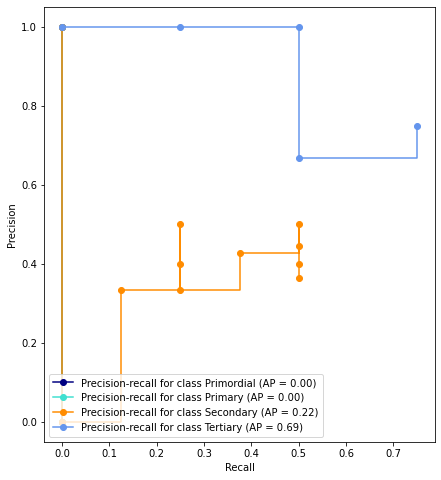

{'Primordial': 0.0, 'Primary': 0.0, 'Secondary': 0.22023809523809523, 'Tertiary': 0.6875}


In [80]:
APs = display_metrics(precisions, recalls)
print(APs)

In [83]:
# mean Average Precision
classes = [
    "Primordial", 
    "Primary",
    "Secondary",
    "Tertiary",
]
APs_list = [APs[cl] for cl in classes]
APs_list = np.array(APs_list)
mAP = APs_list.mean()
print(f"mAP: {mAP}")

mAP: 0.2269345238095238


Your proposition should at least beat this mAP score.

# Quick submission test

You can test any submission locally by running:

```
ramp-test --submission <submission folder>
```
If you want to quickly test the that there are no obvious code errors, use the `--quick-test` flag to only use a small subset of the data.

```
ramp-test --submission <submission folder> --quick-test
```

See the [online documentation](https://paris-saclay-cds.github.io/ramp-docs/ramp-workflow/stable/using_kits.html) for more details.